# Градиентный спуск

In [1]:
import warnings
warnings.simplefilter("ignore", UserWarning)

import pandas as pd
import numpy as np
import random
import copy
from sklearn import preprocessing
from IPython import display
from JSAnimation import IPython_display

import matplotlib.pyplot as plt
import matplotlib.animation as animation
from mpl_toolkits.mplot3d import Axes3D
plt.style.use('classic')

import seaborn as sns
sns.set()

from IPython.display import display

%matplotlib inline

In [2]:
df = pd.read_csv('../data/auto.ru_data.csv')
df.head()

,Год выпуска,КПП,Привод,Пробег,Тип кузова,Состояние,Срок владения,Цвет,Руль,Владельцы,...,Модель,Город,Объем двигателя,Мощность двигателя,Двигатель,Цена,Дата,Количество дней,Просмотров всего,Просмотров в день
0,2012.0,механическая,передний,141000.0,внедорожник 5 дв.,Не требует ремонта,NaN,белый,Левый,2 владельца,...,ix35 I,Воронеж,2.0,150.0,Бензин,790000,2018-06-25,60,387.0,6.450000
1,2014.0,автоматическая,полный,80189.0,внедорожник 5 дв.,Не требует ремонта,NaN,белый,Левый,3 или более,...,X1 I (E84) Рестайлинг 20d,Москва,2.0,184.0,Дизель,1368000,2018-06-25,60,657.0,10.950000
2,2010.0,механическая,передний,143000.0,седан,Не требует ремонта,NaN,бежевый,Левый,3 или более,...,Logan I Рестайлинг,Воронеж,1.4,75.0,Бензин,320000,2018-06-25,60,470.0,7.833333
3,2009.0,механическая,передний,126000.0,седан,Не требует ремонта,NaN,жёлтый,Левый,3 или более,...,Nexia I Рестайлинг,Россошь,1.5,80.0,Бензин,150000,2018-06-25,60,438.0,7.300000
4,2011.0,механическая,передний,159000.0,хэтчбек 5 дв.,Не требует ремонта,NaN,красный,Левый,3 или более,...,C4 II,Воронеж,1.6,120.0,Бензин,410000,2018-06-25,60,442.0,7.366667


In [3]:
def error(X, Y, THETA):
    return np.sum((np.dot(X, THETA) - Y)**2) / (2*Y.size)

In [4]:
class SubplotAnimation(animation.TimedAnimation):
    def __init__(self, x, y, W_history, costs):
        self.x = x
        self.y = y
        self.W_history = W_history
        self.costs = costs
        self.step = 50
        
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))
                
        ax1 = axes[0]
        self.plot1, = ax1.plot([], [])
        X_coors, Y_coors = list(zip(*self.W_history))       
        ax1.set_xlim([min(X_coors) - 10, max(X_coors) + 10])
        ax1.set_ylim([min(Y_coors) - 10, max(Y_coors) + 10])
        ax1.set_title("Коэффициенты уравнения прямой")
        
        ms = np.linspace(min(X_coors) - 10 , max(X_coors) + 10, 10)
        bs = np.linspace(min(Y_coors) - 10 , max(Y_coors) + 10, 20)
        M, B = np.meshgrid(ms, bs)
        zs = np.array([error(x, y, theta) for theta in zip(np.ravel(M), np.ravel(B))])
        Z = zs.reshape(M.shape)
        ax1.contour(M, B, Z, 20, color='b', alpha=0.5, offset=0, stride=30)

        ax2 = axes[1]
        ax2.scatter(self.x[:, 1], self.y)
        self.plot2, = ax2.plot([], [])
        ax2.set_xlim([min(self.x[:, 1]) - 1, max(self.x[:, 1]) + 1])
        ax2.set_ylim([min(y) - 1, max(y) + 1])
        ax2.set_title("График прямой")
                
        ax3 = axes[2]
        self.plot3, = ax3.plot([], [])
        X_coors, Y_coors = list(zip(*self.W_history))       
        ax3.set_xlim([0, len(self.costs) + 1])
        ax3.set_ylim([0, max(np.array(self.costs)[np.isfinite(self.costs)])])
        ax3.set_title("График ошибки")

        animation.TimedAnimation.__init__(self, fig, interval=200, blit=True)

    def _draw_frame(self, framedata):
        i = framedata

        self.plot1.set_data(*zip(*self.W_history[:(i+1)]))
        self.plot2.set_data(self.x[:, 1], self.W_history[i][0] + self.W_history[i][1]*self.x[:, 1])
        self.plot3.set_data(range(i), self.costs[:i])
        
        self._drawn_artists = [self.plot1, self.plot2, self.plot3]

    def new_frame_seq(self):
        return iter([i for i in range(0, len(self.W_history)) if i < 25 or i % self.step == 0] + [len(self.W_history) - 1])

    def _init_draw(self):
        plots = [self.plot1, self.plot2, self.plot3]
        for plot in plots:
            plot.set_data([], [])

In [5]:
class SurfaceAnimation(animation.TimedAnimation):
    def __init__(self, x, y, W_history, costs, elev=None, azim=None):
        self.x = x
        self.y = y
        self.W_history = W_history
        self.costs = costs
        self.step = 50
        
        fig = plt.figure(figsize=(7, 5))
        ax = fig.add_subplot(111, projection='3d')
                
        self.plot1, = ax.plot([], [], [], markerfacecolor='red', markeredgecolor='red', marker='.', markersize=2)
        self.plot2, = ax.plot([], [], [], markerfacecolor='blue', markeredgecolor='blue', marker='.', markersize=2)

        X_coors, Y_coors = list(zip(*self.W_history))       
        ax.set_xlim([min(X_coors) - 10, max(X_coors) + 10])
        ax.set_ylim([min(Y_coors) - 10, max(Y_coors) + 10])
        ax.set_title("Коэффициенты уравнения прямой")
        
        ms = np.linspace(min(X_coors) - 10 , max(X_coors) + 10, 10)
        bs = np.linspace(min(Y_coors) - 10 , max(Y_coors) + 10, 20)
        M, B = np.meshgrid(ms, bs)
        zs = np.array([error(x, y, theta) for theta in zip(np.ravel(M), np.ravel(B))])
        Z = zs.reshape(M.shape)
        ax.contour(M, B, Z, 20, color='b', alpha=0.5, offset=0, stride=30)
        
        ax.plot_surface(M, B, Z, rstride=1, cstride=1, color='b', alpha=0.2)
        
        ax.set_xlabel('Intercept')
        ax.set_ylabel('Slope')
        ax.set_zlabel('Cost')
        ax.view_init(elev=elev, azim=azim)

        animation.TimedAnimation.__init__(self, fig, interval=200, blit=True)

    def _draw_frame(self, framedata):
        i = framedata

        self.plot1.set_data([t[0] for t in self.W_history[:(i+1)]], [t[1] for t in self.W_history[:(i+1)]])
        self.plot1.set_3d_properties(self.costs[:(i+1)])
        
        self.plot2.set_data([t[0] for t in self.W_history[:(i+1)]], [t[1] for t in self.W_history[:(i+1)]])
        self.plot2.set_3d_properties([0]*(i+1))
        
        
        self._drawn_artists = [self.plot1, self.plot2]

    def new_frame_seq(self):
        return iter([i for i in range(0, len(self.W_history)) if i < 25 or i % self.step == 0] + [len(self.W_history) - 1])

    def _init_draw(self):
        plots = [self.plot1, self.plot2]
        for plot in plots:
            plot.set_data([], [])

In [6]:
def result_animation(x, y, W_history, costs, elev=None, azim=None):
    anim = SubplotAnimation(x, y, W_history, costs)
    surf_anim = SurfaceAnimation(x, y, W_history, costs, elev, azim)
    
    display(anim)
    display(surf_anim)
    
    return anim, surf_anim

In [7]:
def generalGradientDescent(x, y, W0, alpha, max_iterations, batch_size, precision=0.0001, scale=False):
    plt.ion()

    X = copy.copy(x)
    Y = copy.copy(y)
    n = len(Y)
    W = W0
    
    if scale:
        # Масштабирование
        Y = preprocessing.scale(Y, with_mean=False)
        X = preprocessing.scale(X, with_mean=False)

    W_history = []
    costs = []
    H_history = []
    grads = []

    counter = 0
    oldcost = 0
    epoch = 0
    i = 0
    
    start = i*batch_size
    stop = (i + 1)*batch_size
    hypothesis = np.dot(X[start:stop, :], W)
    loss = hypothesis - Y[start:stop]
    gradient = np.dot(X[start:stop, :].T, loss) / (stop - start)
    currentcost = np.sum(loss**2) / 2
    
    counter += 1
    costsum = currentcost
    W_history.append(W)
    H_history.append(hypothesis)
    costs.append(costsum / (i*batch_size + X[start:stop, :].shape[0]))
    grads.append(gradient)    
    i += 1
    
    while abs(costs[counter-1] - oldcost) > precision:
        oldcost = currentcost
        
        start = i*batch_size
        stop = (i + 1)*batch_size
        
        hypothesis = np.dot(X[start:stop, :], W)
        H_history.append(hypothesis)

        loss = hypothesis - Y[start:stop]
        currentcost = np.sum(loss**2) / 2
               
        gradient = np.dot(X[start:stop, :].T, loss) / (stop - start)
        grads.append(gradient)
               
        W = W - alpha * gradient
        W_history.append(W)
        
        counter += 1
        costsum += currentcost
        oldcost = costs[counter - 2]
        costs.append(costsum / (i*batch_size + X[start:stop, :].shape[0]))

        i += 1
        if stop > n:
            epoch += 1
            neworder = np.random.permutation(n)
            X = X[neworder]
            Y = Y[neworder]
            i = 0
            costsum = 0
               
        if counter == max_iterations:
            break
           
    return W_history, costs, H_history, counter, epoch

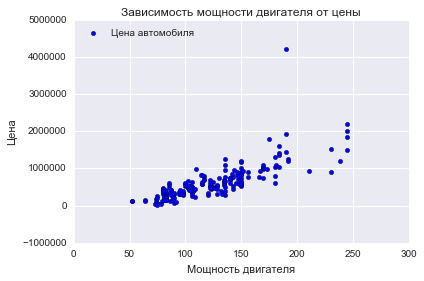

In [8]:
# Набор данных 
dfs = df[(df['Пробег'] < 100000) & (df['Пробег'] > 10000) & (df['Мощность двигателя'] < 249)].reset_index(drop=True)
dfs = dfs.loc[:200]
plt.scatter(dfs['Мощность двигателя'], dfs['Цена'], label='Цена автомобиля')
plt.title("Зависимость мощности двигателя от цены")
plt.xlabel("Мощность двигателя")
plt.ylabel("Цена")
plt.legend(loc='upper left')
plt.show()

In [9]:
y = dfs['Цена'].values / 1000
x = np.ones((len(y), 2))
x[:, 1] = dfs['Мощность двигателя'].values

In [10]:
scaled_y = preprocessing.scale(y, with_mean=False)
scaled_x = preprocessing.scale(x, with_mean=False)

# Стохастический градиентный спуск

In [11]:
def stochasticGradientDescent(x, y, W0, alpha, max_iterations, precision=0.0001, scale=False):
    return generalGradientDescent(x, y, W0, alpha, max_iterations, 1, precision, scale)

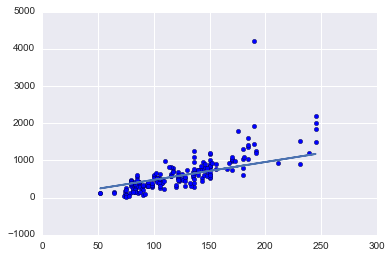

In [12]:
# Сходится без масштабирования.
W0 = np.array([-1, -1])
alpha = 0.00001
max_iterations = 1000000000000
precision = 0.0001
scale = False

stoch_W_history, stoch_costs, stoch_H_history, stoch_counter, stoch_epoch = stochasticGradientDescent(x, y, W0, alpha, max_iterations, precision, scale)
stoch_W = stoch_W_history[-1]

plt.scatter(x[:, 1], y)
plt.plot(x[:, 1], stoch_W[0] + stoch_W[1]*x[:, 1])
plt.show()

/Users/alexanderkulikov/anaconda3/lib/python3.6/site-packages/matplotlib/contour.py:960: UserWarning: The following kwargs were not used by contour: 'color', 'offset', 'stride'
  s)
/Users/alexanderkulikov/anaconda3/lib/python3.6/site-packages/matplotlib/contour.py:960: UserWarning: The following kwargs were not used by contour: 'color'
  s)



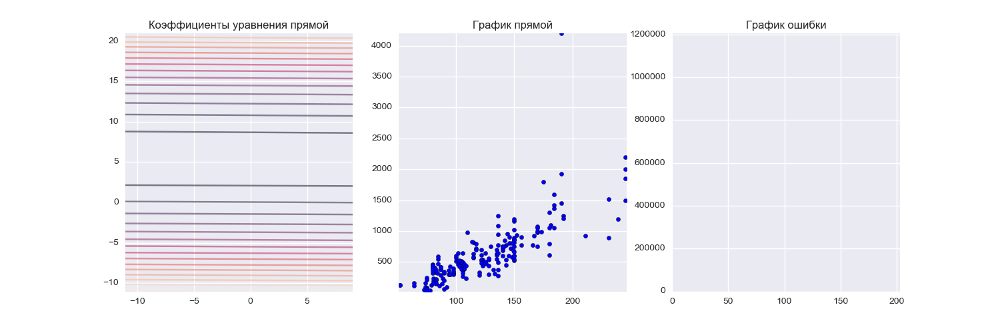
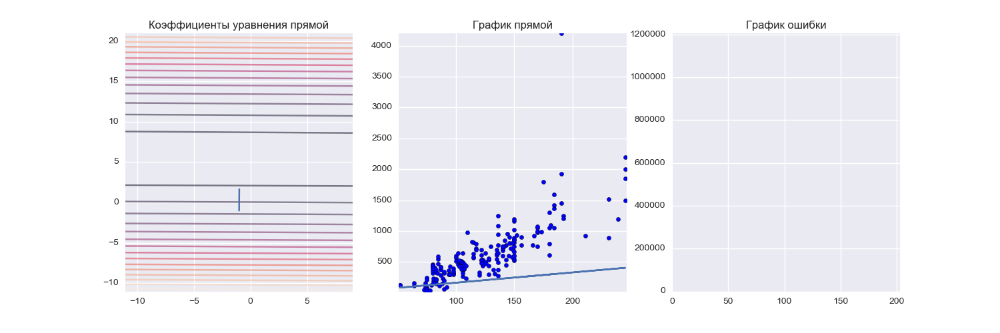
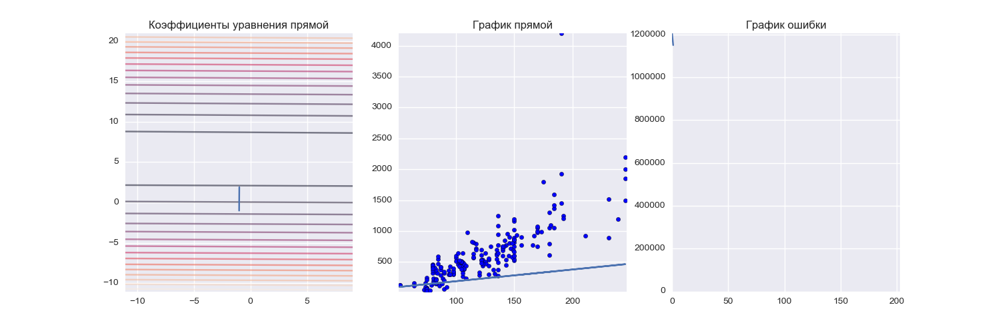
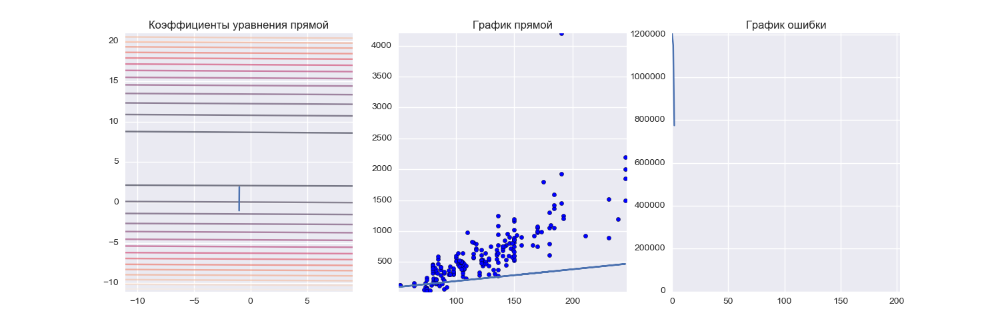
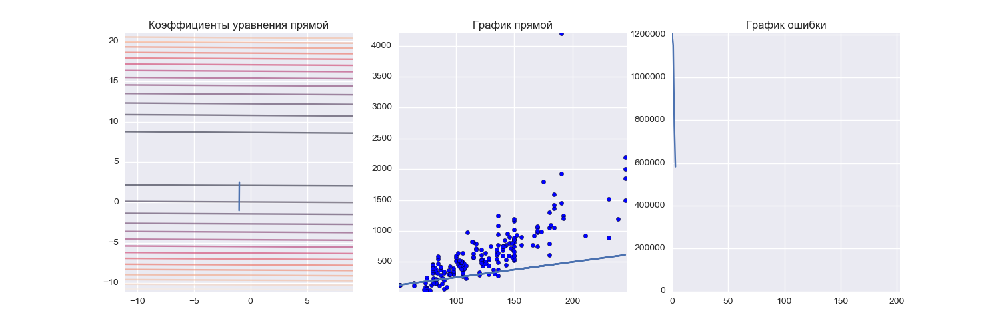
...
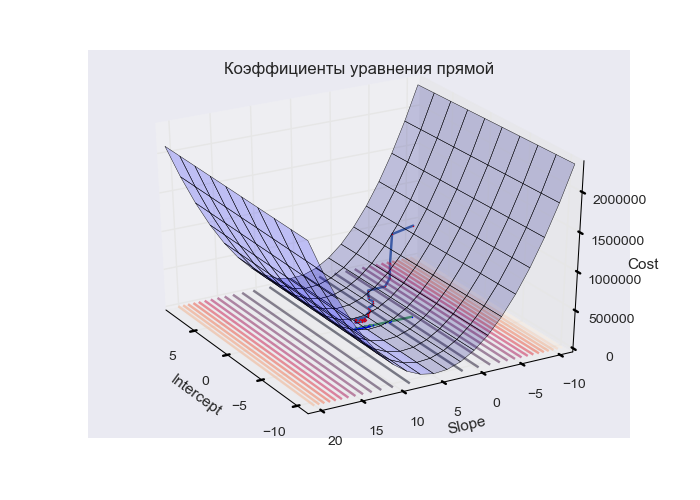
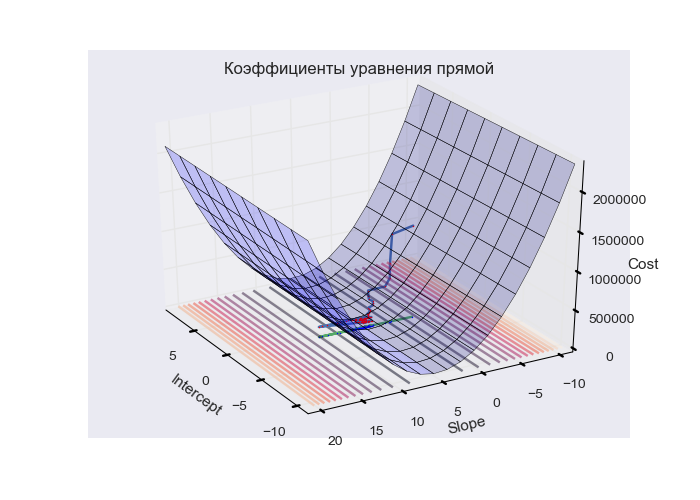
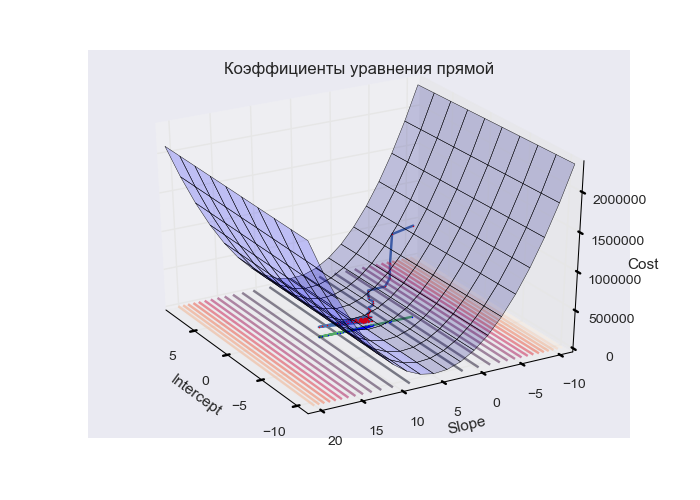
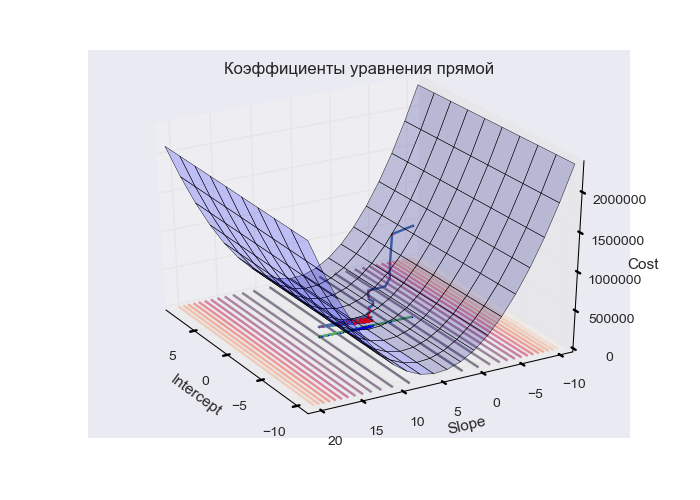
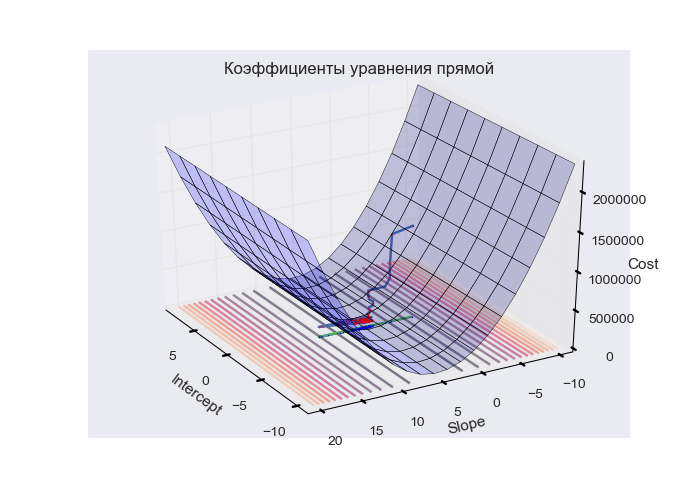

In [13]:
anim, surf_anim = result_animation(x, y, stoch_W_history, stoch_costs, 30, 150)

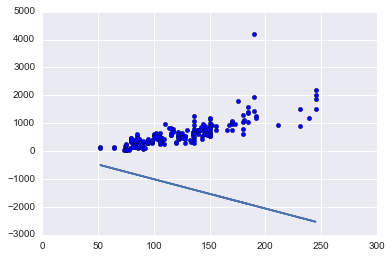

In [15]:
# Расходится без масштабирования.
W0 = np.array([-1, -1])
alpha = 0.00013
max_iterations = 1000000000000
precision = 0.0001
scale = False

stoch_W_history, stoch_costs, stoch_H_history, stoch_counter, stoch_epoch = stochasticGradientDescent(x, y, W0, alpha, max_iterations, precision, scale)
stoch_W = stoch_W_history[-1]

plt.scatter(x[:, 1], y)
plt.plot(x[:, 1], stoch_W[0] + stoch_W[1]*x[:, 1])
plt.show()

/Users/alexanderkulikov/anaconda3/lib/python3.6/site-packages/matplotlib/contour.py:960: UserWarning: The following kwargs were not used by contour: 'color', 'offset', 'stride'
  s)
/Users/alexanderkulikov/anaconda3/lib/python3.6/site-packages/matplotlib/contour.py:960: UserWarning: The following kwargs were not used by contour: 'color'
  s)



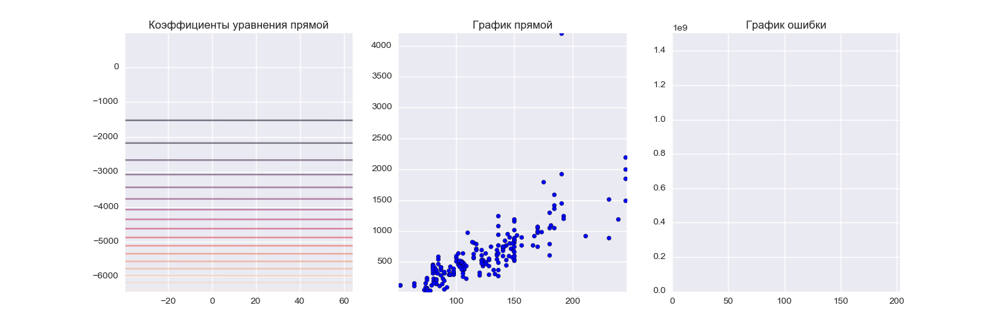
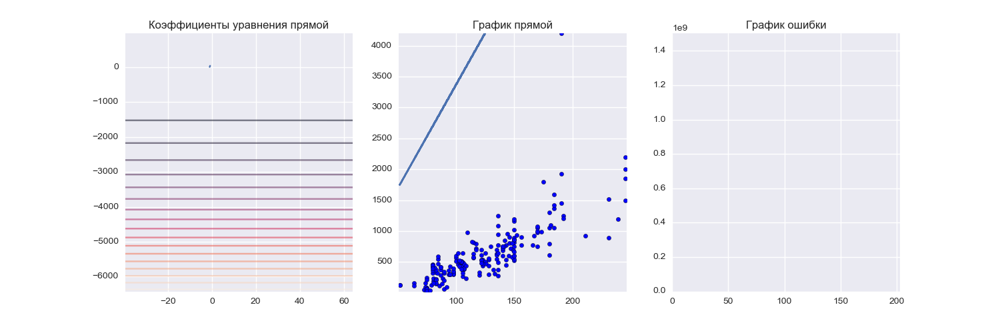
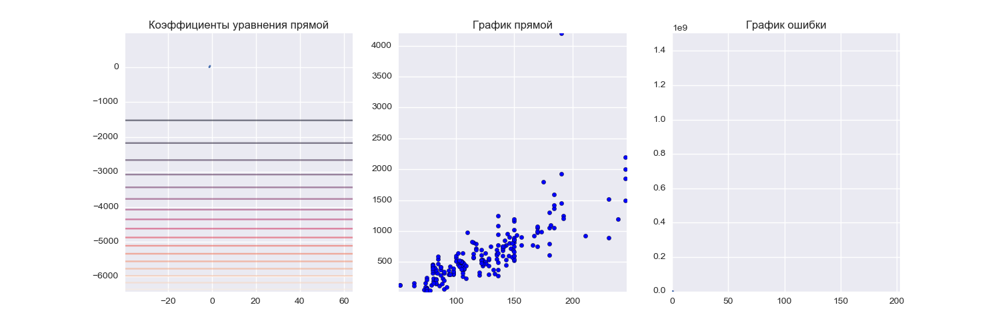
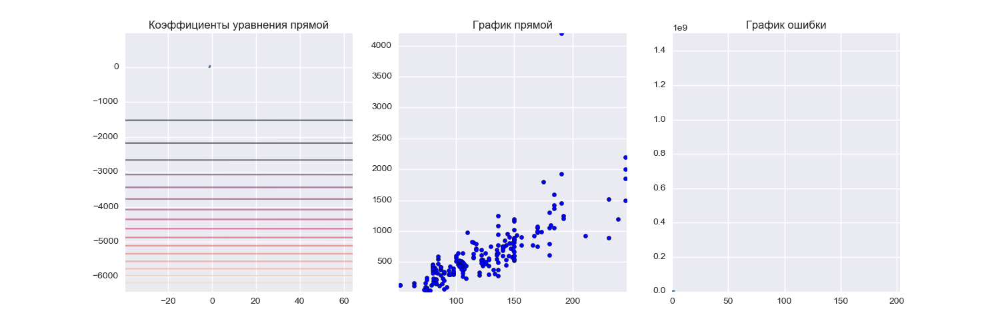
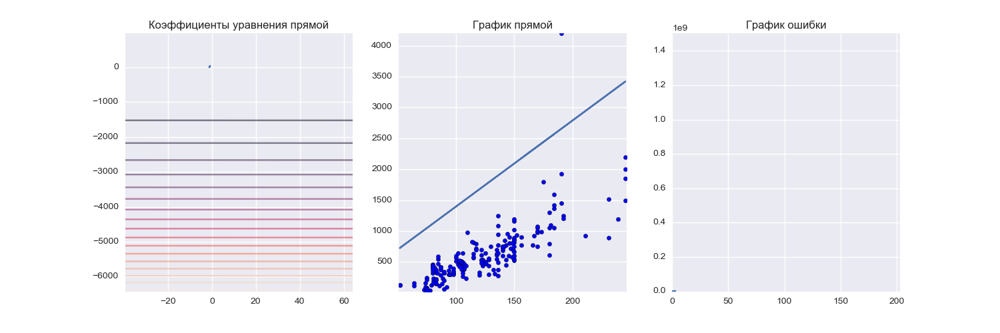
...
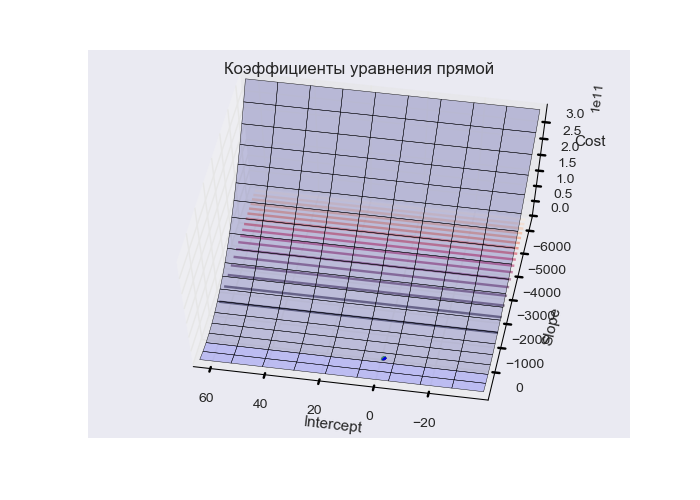
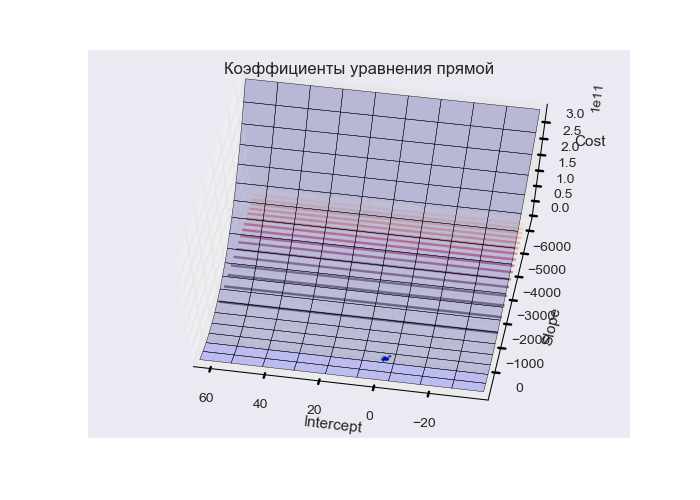
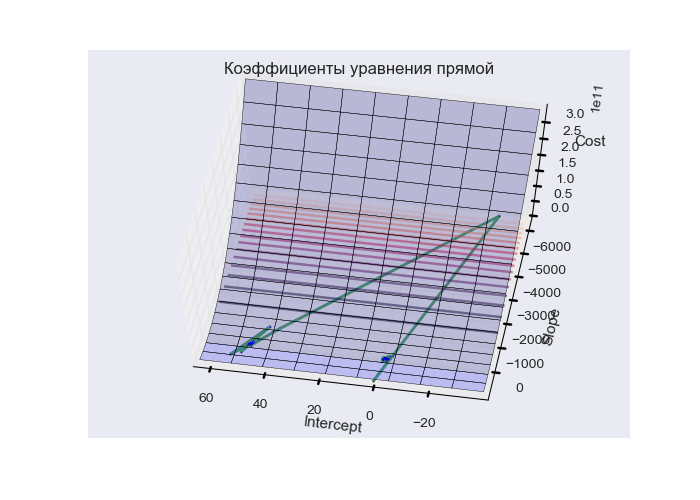
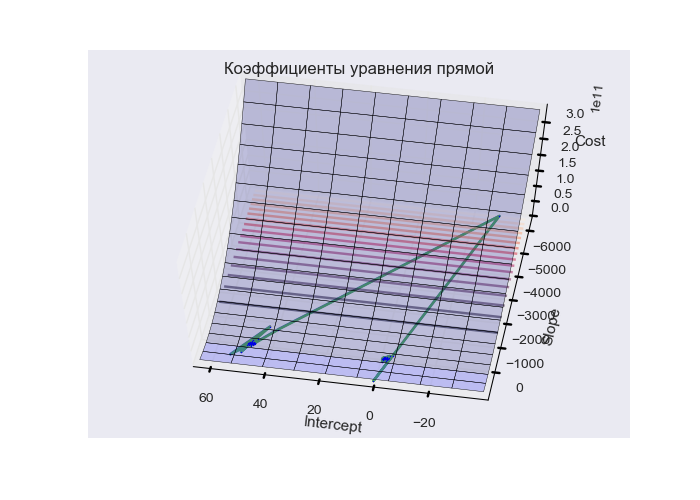
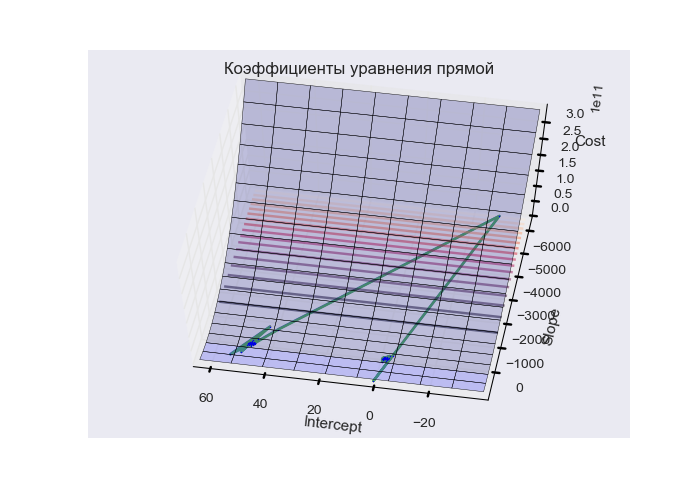

In [16]:
anim, surf_anim = result_animation(x, y, stoch_W_history, stoch_costs, 60, 100)

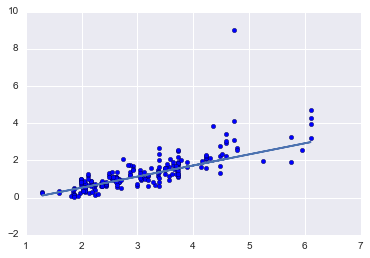

In [17]:
# Сходится с масштабированием.
W0 = np.array([-1, -1])
alpha = 0.01
max_iterations = 1000000000000
precision = 0.0001
scale = True

stoch_W_history, stoch_costs, stoch_H_history, stoch_counter, stoch_epoch = stochasticGradientDescent(x, y, W0, alpha, max_iterations, precision, scale)
stoch_W = stoch_W_history[-1]

plt.scatter(scaled_x[:, 1], scaled_y)
plt.plot(scaled_x[:, 1], stoch_W[0] + stoch_W[1]*scaled_x[:, 1])
plt.show()

/Users/alexanderkulikov/anaconda3/lib/python3.6/site-packages/matplotlib/contour.py:960: UserWarning: The following kwargs were not used by contour: 'color', 'offset', 'stride'
  s)
/Users/alexanderkulikov/anaconda3/lib/python3.6/site-packages/matplotlib/contour.py:960: UserWarning: The following kwargs were not used by contour: 'color'
  s)



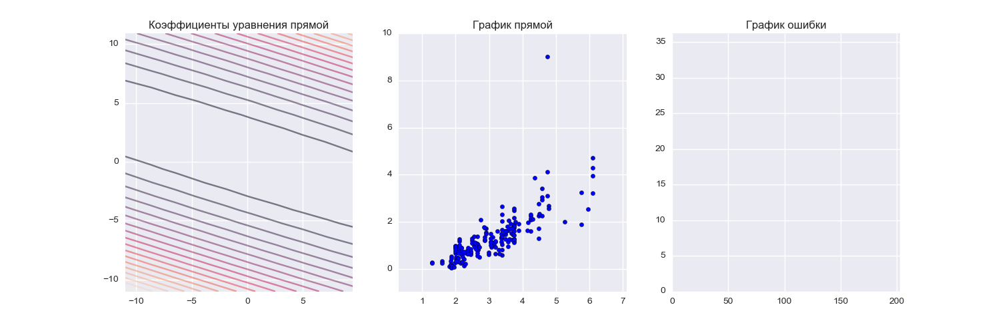
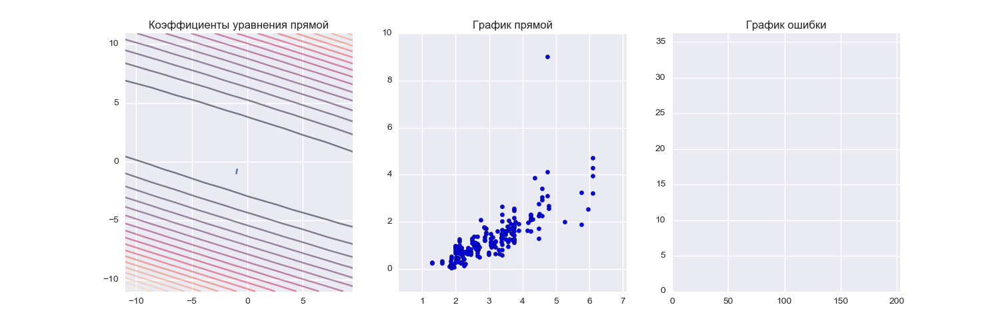
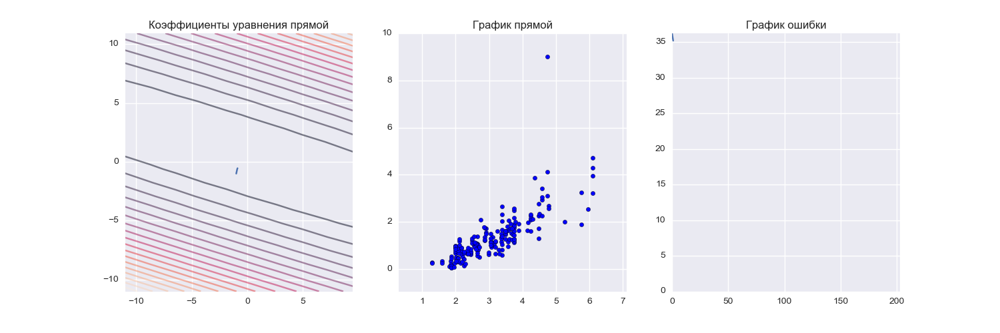
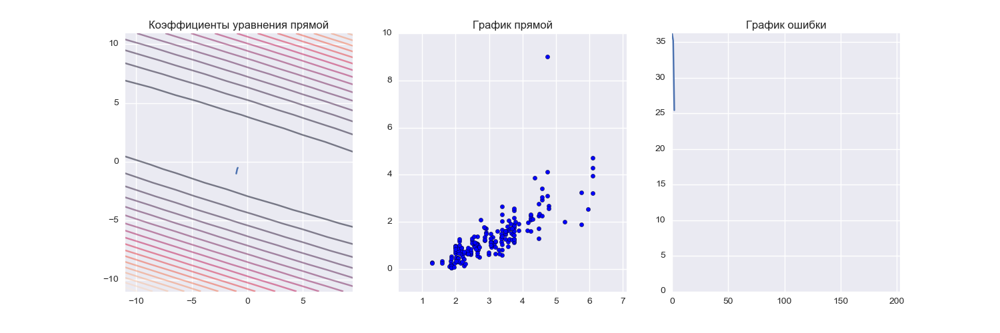
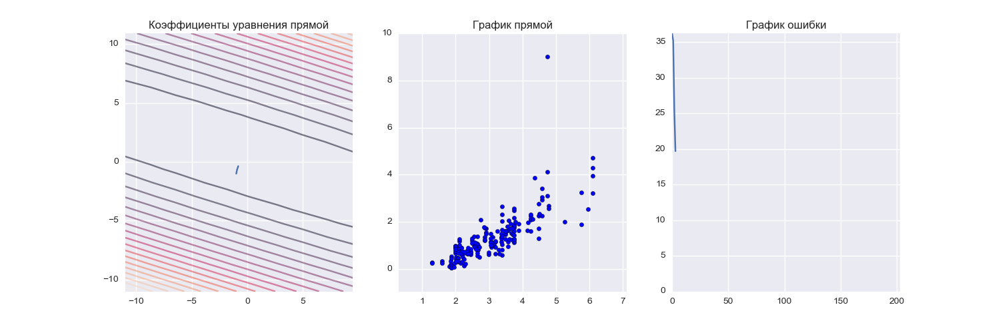
...
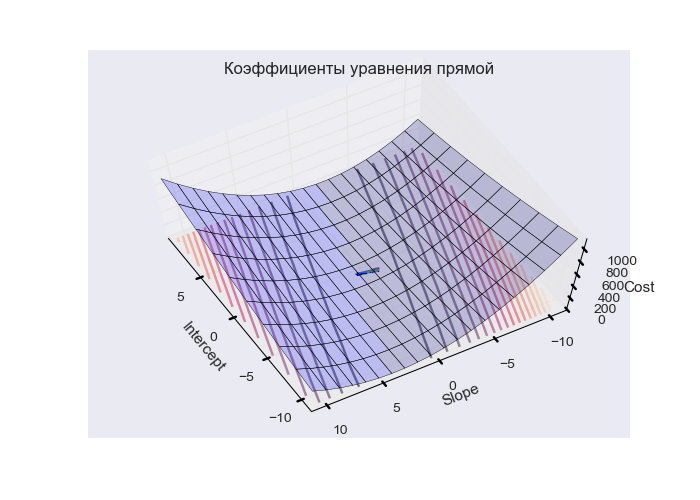
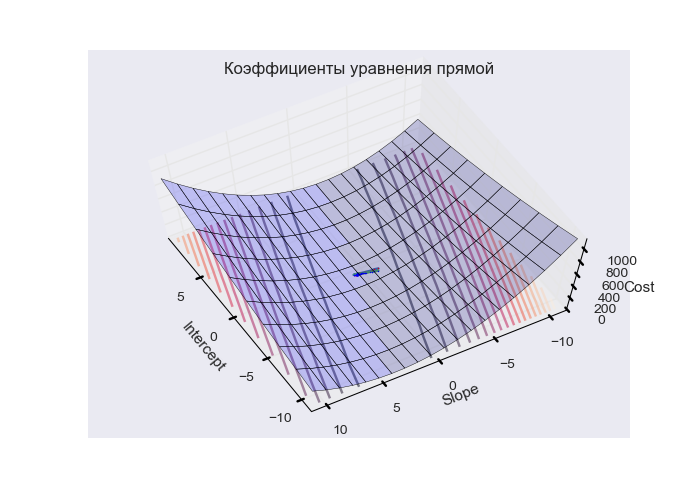
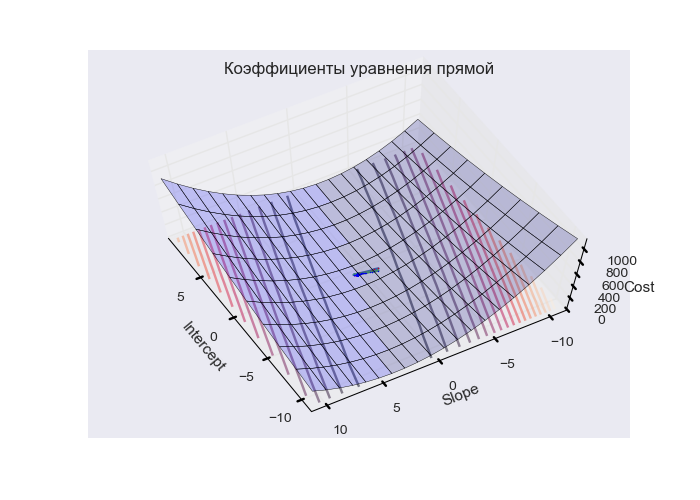
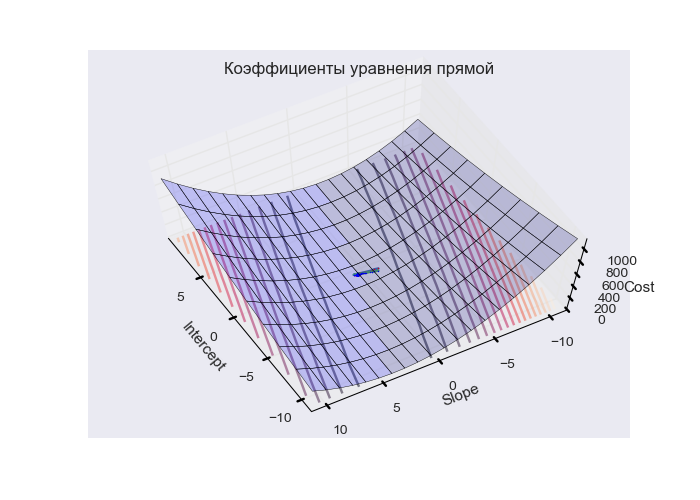
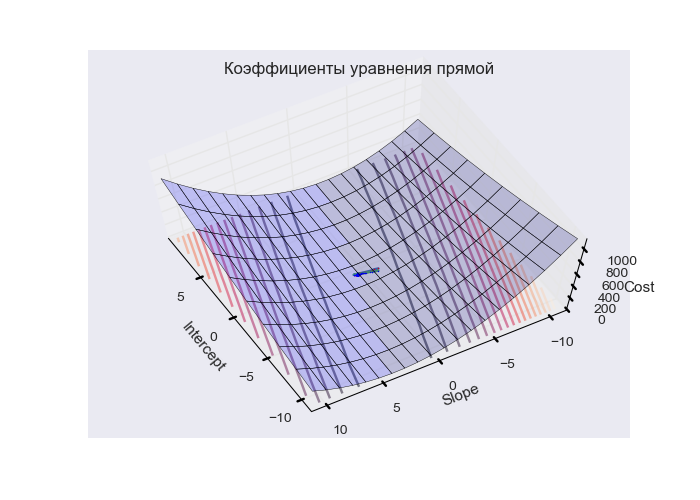

In [18]:
anim, surf_anim = result_animation(scaled_x, scaled_y, stoch_W_history, stoch_costs, 70, 150)

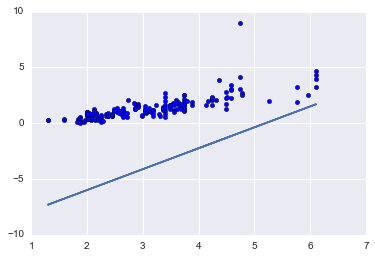

In [19]:
# Расходится с масштабированием.
W0 = np.array([-10, -1])
alpha = 0.15
max_iterations = 1000000000000
precision = 0.0001
scale = True

stoch_W_history, stoch_costs, stoch_H_history, stoch_counter, stoch_epoch = stochasticGradientDescent(x, y, W0, alpha, max_iterations, precision, scale)
stoch_W = stoch_W_history[-1]

plt.scatter(scaled_x[:, 1], scaled_y)
plt.plot(scaled_x[:, 1], stoch_W[0] + stoch_W[1]*scaled_x[:, 1])
plt.show()

/Users/alexanderkulikov/anaconda3/lib/python3.6/site-packages/matplotlib/contour.py:960: UserWarning: The following kwargs were not used by contour: 'color', 'offset', 'stride'
  s)
/Users/alexanderkulikov/anaconda3/lib/python3.6/site-packages/matplotlib/contour.py:960: UserWarning: The following kwargs were not used by contour: 'color'
  s)



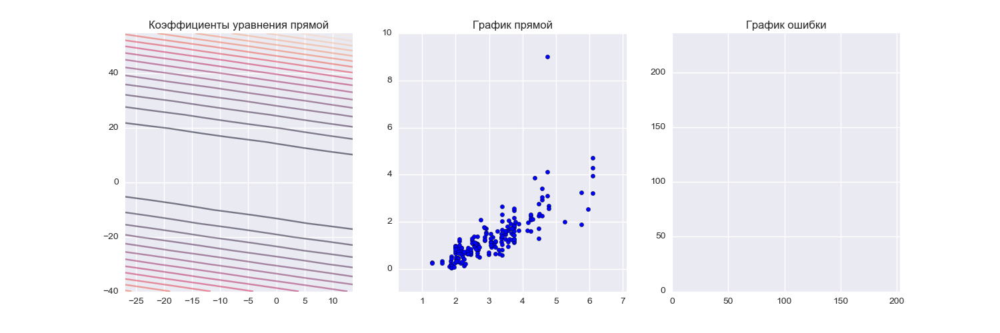
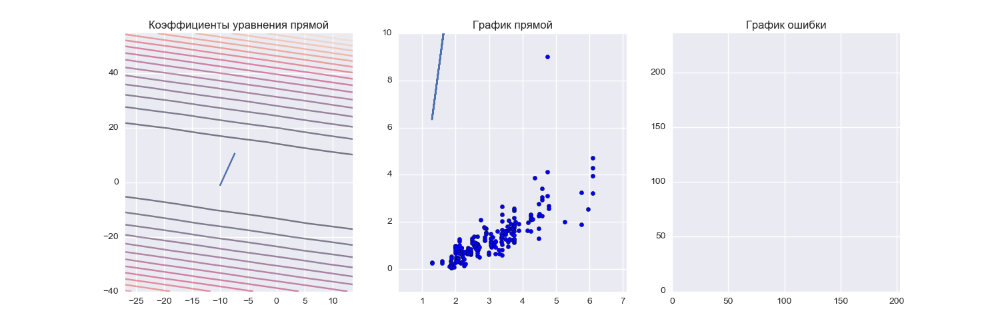
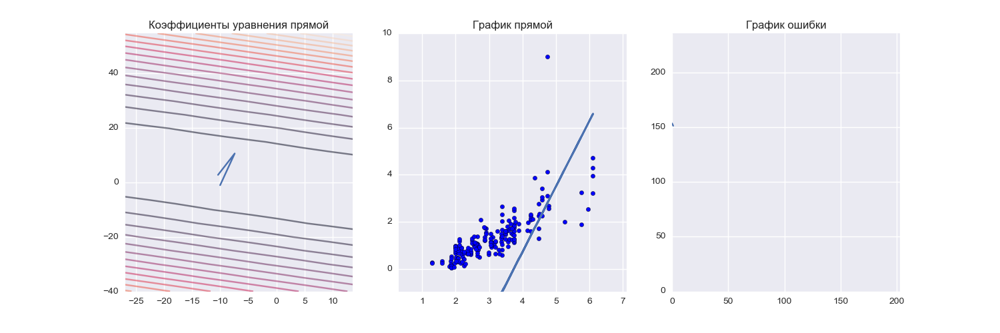
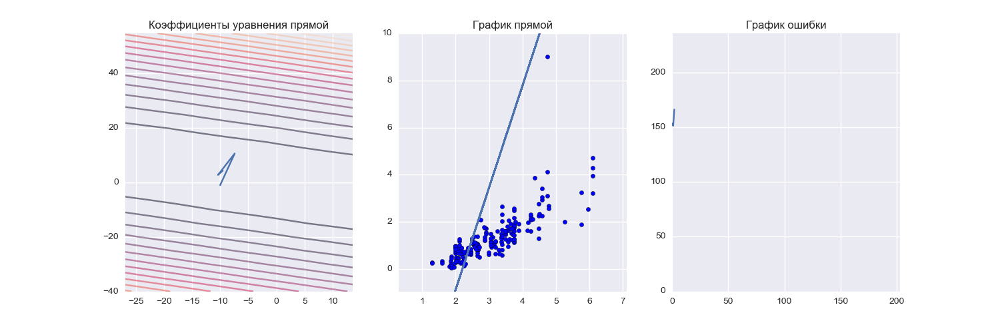
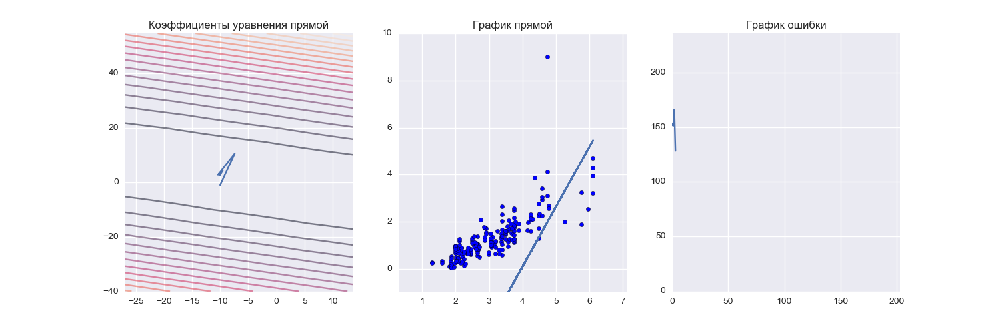
...
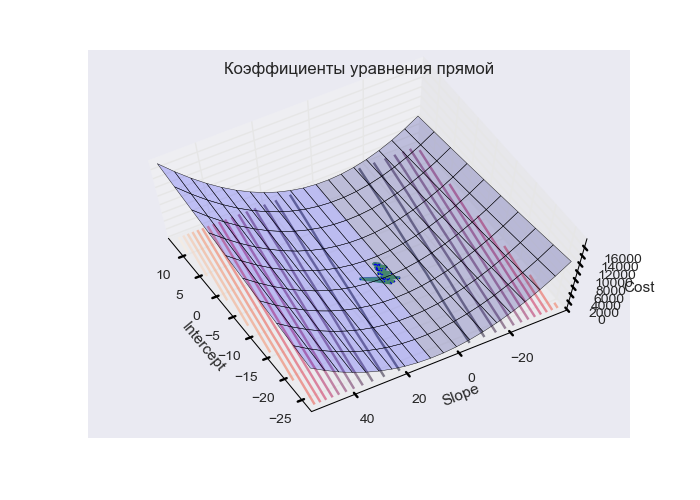
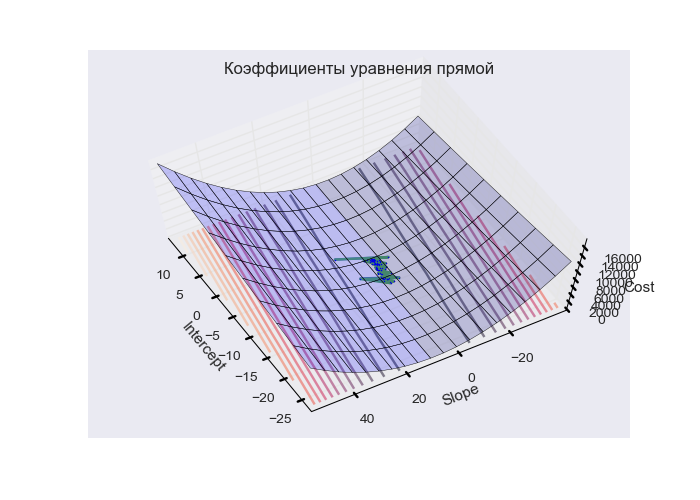
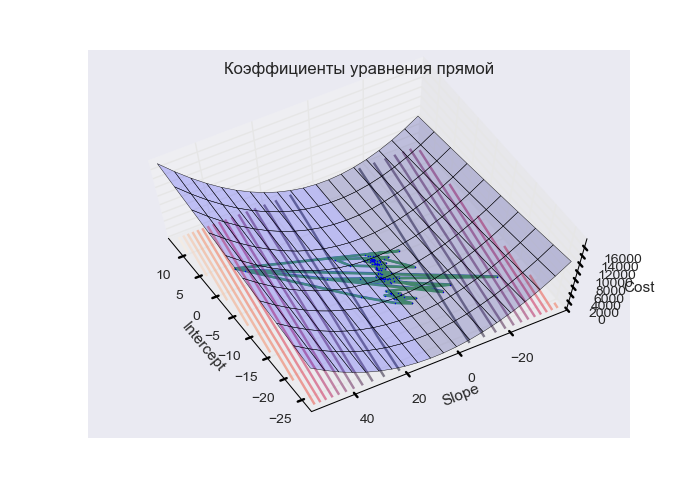
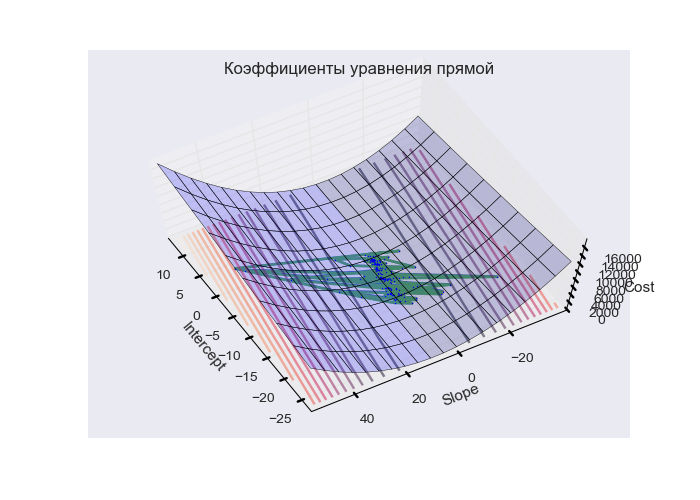
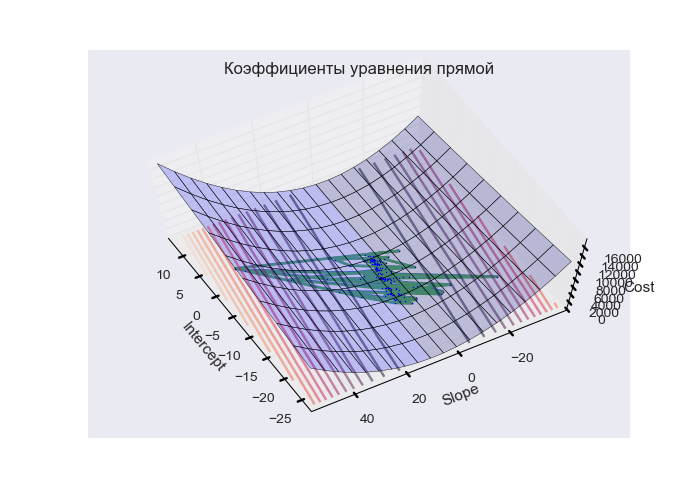

In [20]:
anim, surf_anim = result_animation(scaled_x, scaled_y, stoch_W_history, stoch_costs, 70, 150)

# Градиентный спуск по минибатчам

In [21]:
def minibatchGradientDescent(x, y, W0, alpha, max_iterations, batch_size, precision=0.0001, scale=False):
    return generalGradientDescent(x, y, W0, alpha, max_iterations, batch_size, precision, scale)

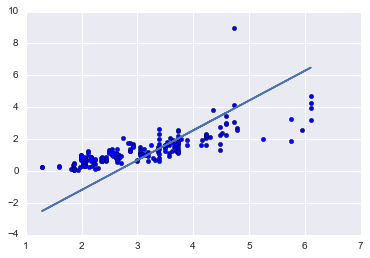

In [22]:
# Cходится с масштабированием (стохастический градиент расходился).
W0 = np.array([-10, -1])
alpha = 0.15
max_iterations = 1000000000000
batch_size = 100
precision = 0.0001
scale = True

batch_W_history, batch_costs, batch_H_history, batch_counter, batch_epoch = minibatchGradientDescent(x, y, W0, alpha, max_iterations, batch_size, precision, scale)
batch_W = batch_W_history[-1]

plt.scatter(scaled_x[:, 1], scaled_y)
plt.plot(scaled_x[:, 1], batch_W[0] + batch_W[1]*scaled_x[:, 1])
plt.show()

/Users/alexanderkulikov/anaconda3/lib/python3.6/site-packages/matplotlib/contour.py:960: UserWarning: The following kwargs were not used by contour: 'color', 'offset', 'stride'
  s)
/Users/alexanderkulikov/anaconda3/lib/python3.6/site-packages/matplotlib/contour.py:960: UserWarning: The following kwargs were not used by contour: 'color'
  s)



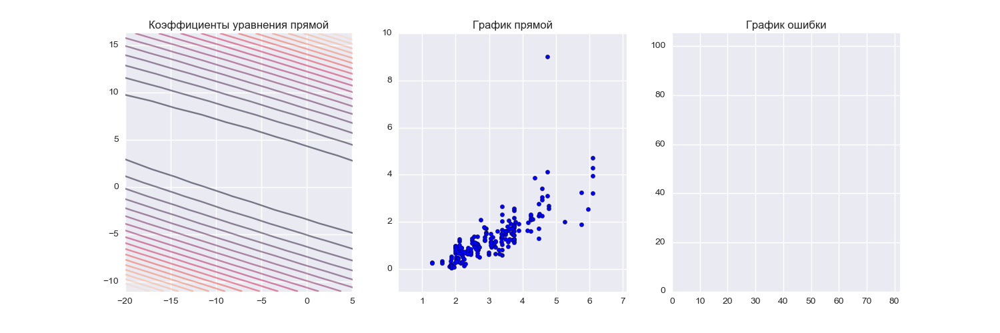
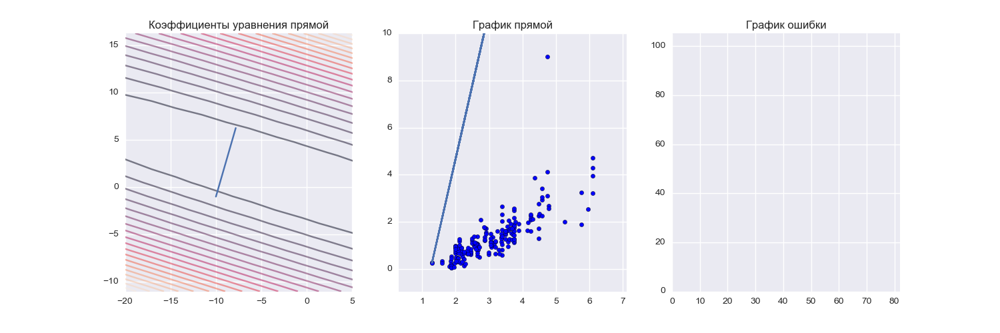
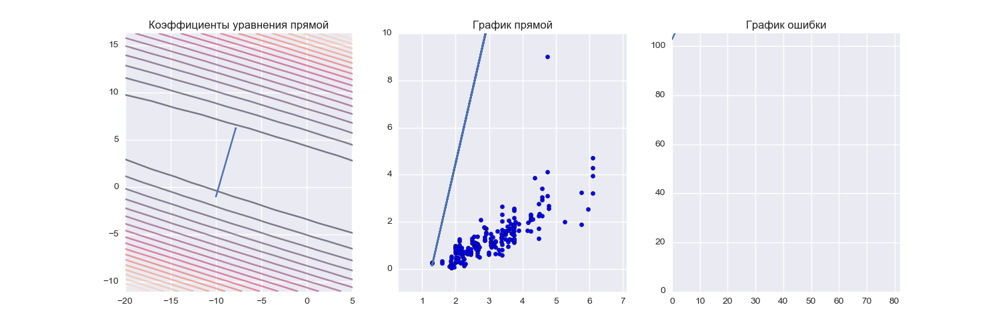
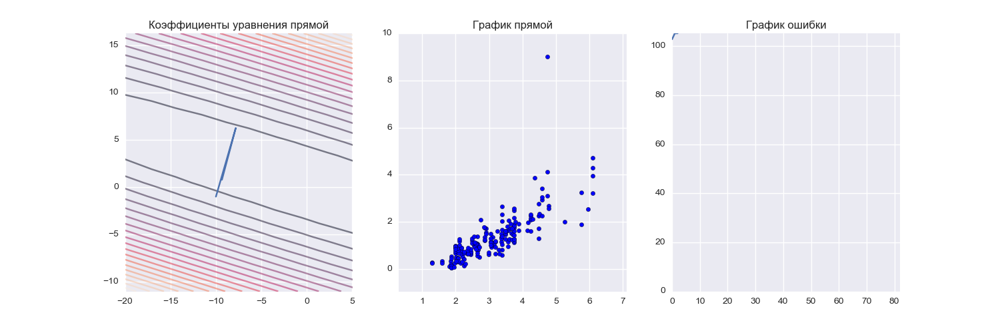
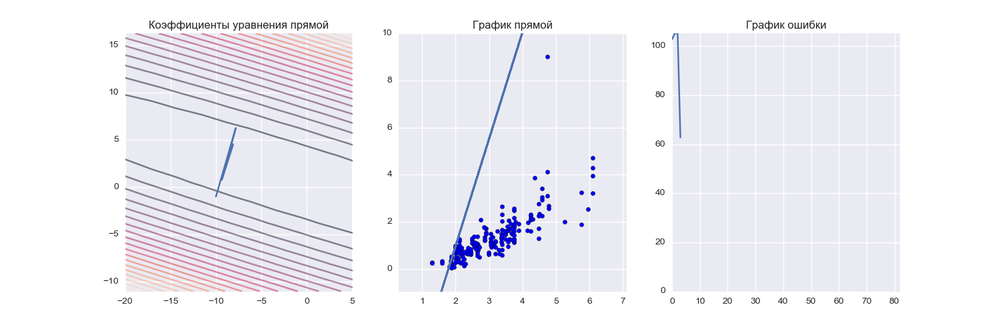
...
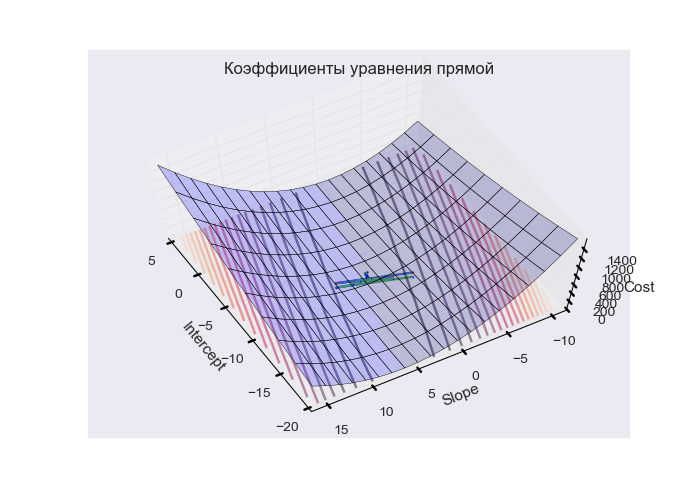
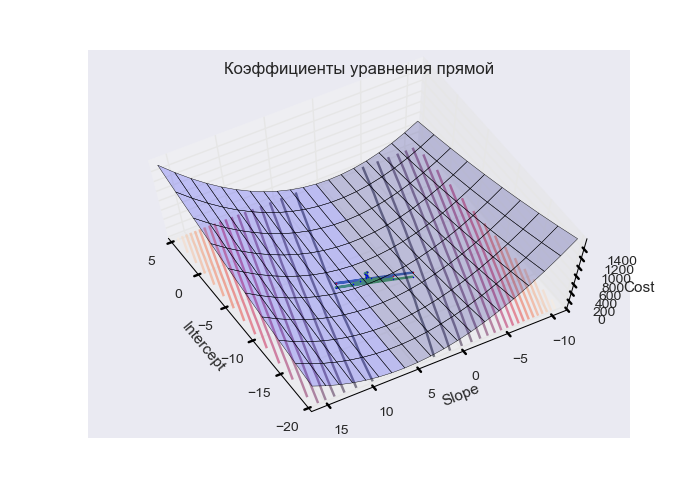
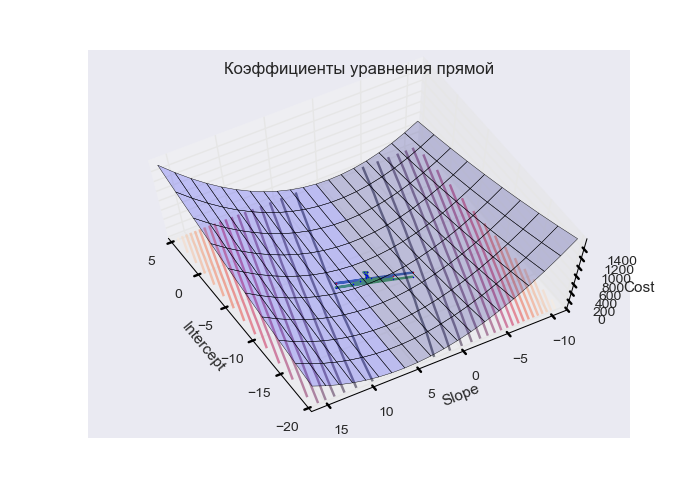
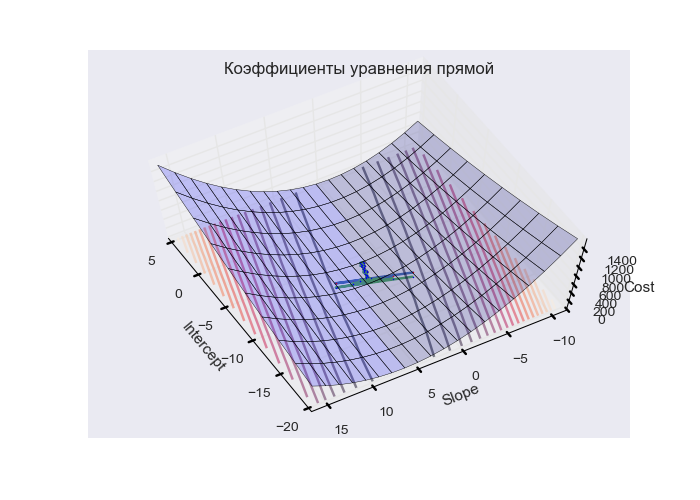
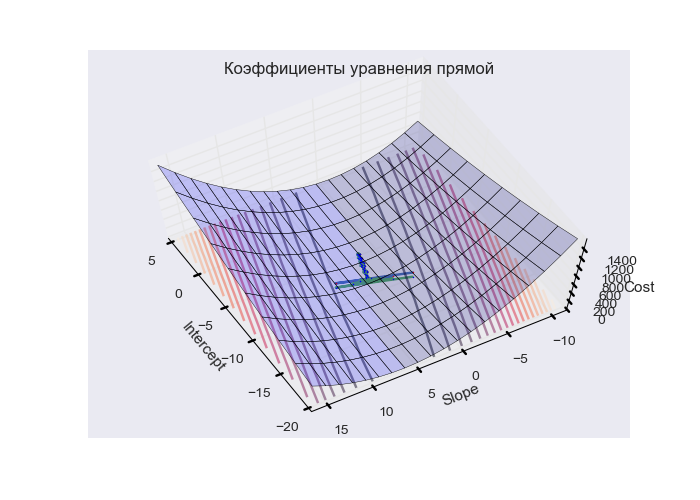

In [23]:
anim, surf_anim = result_animation(scaled_x, scaled_y, batch_W_history, batch_costs, 70, 150)